# Advanced Lane Finding

In this project, the goal is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car. The camera calibration images, test road images, and project videos are available in the project repository or in the repository folder included with the workspace.

Steps we’ve covered so far:

* Exploration Image
* Calibrating Camera
* Correcting for Distortion
* Color/gradient threshold
* Perspective Transform
* Locate the Lane Lines
* Determine the lane curvature
* Inverse Transform
* Pipeline


The first thing you'll do is to compute the camera calibration matrix and distortion coefficients. You only need to compute these once, and then you'll apply them to undistort each new frame. Next, you'll apply thresholds to create a binary image and then apply a perspective transform.

# 1. Exploration Image

Lets have a look at a sample image, to be used for caliberation. Print out the size of the image.

In [1]:
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import os

%matplotlib inline

In [2]:
#reading in an especific image
image = mpimg.imread('camera_cal/calibration7.jpg')

#function used to show a list of images
def show_image(img, cols=1, fig_size=(17, 17), cmap='Greys_r'):
    
    #printing out some stats and plotting
    plt.figure(figsize=fig_size)
    plt.subplot(1, 1, 1)
    plt.imshow(img, cmap=cmap)
    plt.tight_layout()
    plt.show()
   
    #printing out some stats and plotting
    print('This image is:', type(image), 'with dimesions:', image.shape)

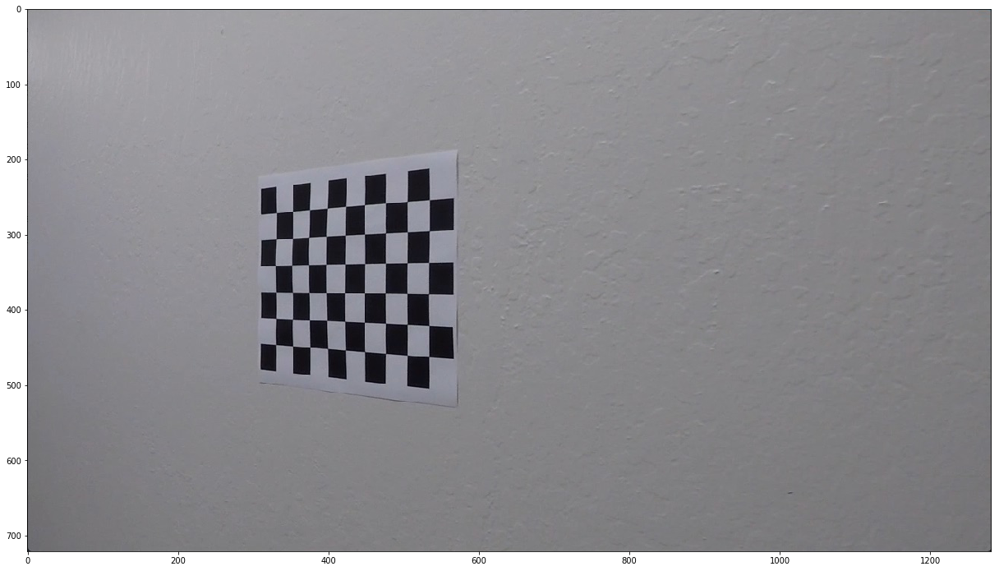

This image is: <class 'numpy.ndarray'> with dimesions: (721, 1281, 3)


In [3]:
# Display the image
show_image(image)

# 2. Calibrating Camera

The first step in the project is to remove any distortion from the images by calculating the camera calibration matrix and distortion coefficients using a series of images of a chessboard.

We can observe on the image above that there are 9 corners in a row and 6 corners in a column. I have used os.listdir to iterate over all the calibrating_camera images to extract the object and image points.

In [158]:
def calibrating_camera(show=True, directory=None):

    global objpoints
    global imgpoints
    global calibrateCamera

    nx = 9  # Corners in a row
    ny = 6  # Corners in a column

    # Read in and make a list of calibration images
    test_img_dir = directory
    images = os.listdir(test_img_dir)
    images = list(map(lambda name: test_img_dir + name, images))

    # Arrays to store object points and image points from all the images
    objpoints = [] # 3D points in real world space
    imgpoints = [] # 2D points in image plane

    # Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ...,(9,6,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2) # x, y coordinates

    for fname in (images):
        # read in each image
        img = mpimg.imread(fname)

        # Convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

        # If corner are found, add object points, image points
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)

            if show == True:
                # Draw and display the corners
                cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
                f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
                ax1.set_title('Original Image', fontsize=15)
                ax1.imshow(mpimg.imread(fname))
                ax2.set_title('With Corners', fontsize=15)
                ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
             
    img_size = img.shape[1], img.shape[0]
    calibrateCamera = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

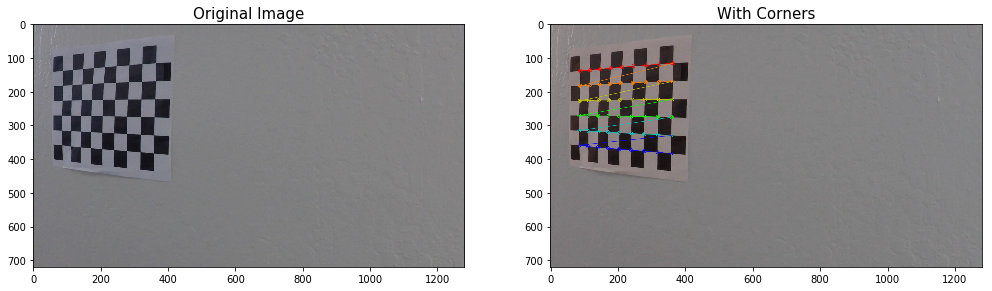

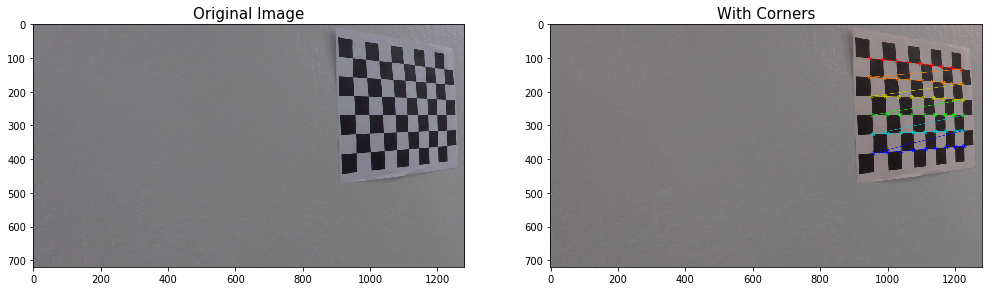

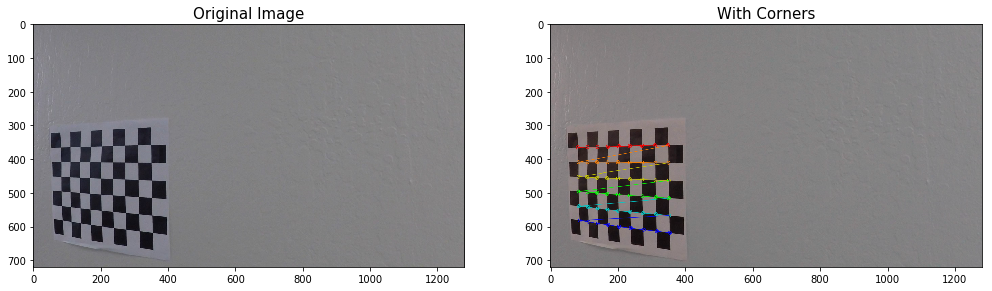

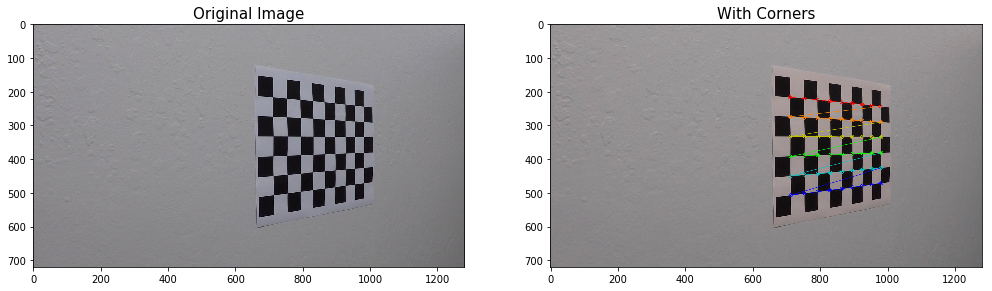

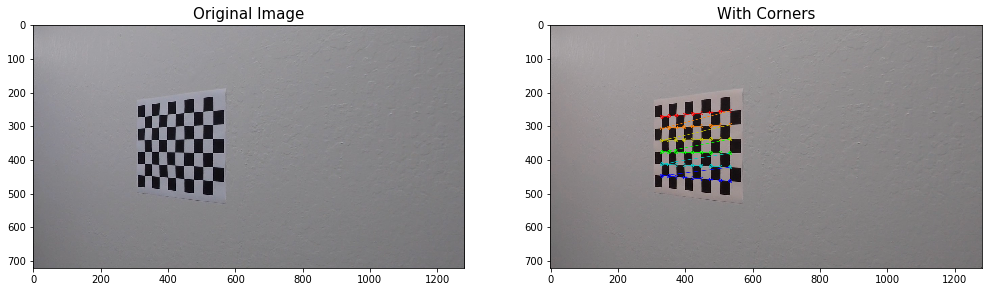

...

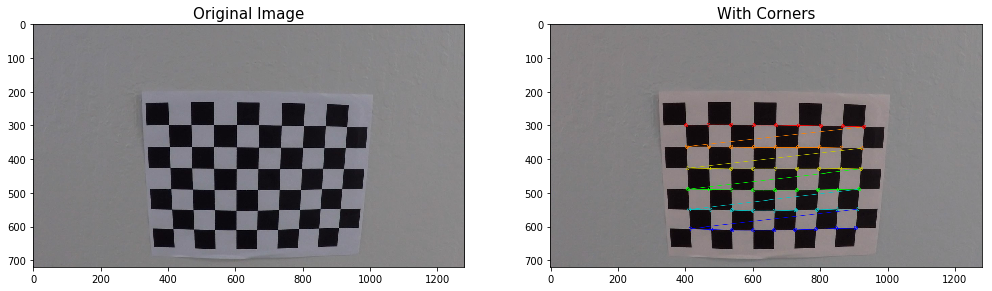

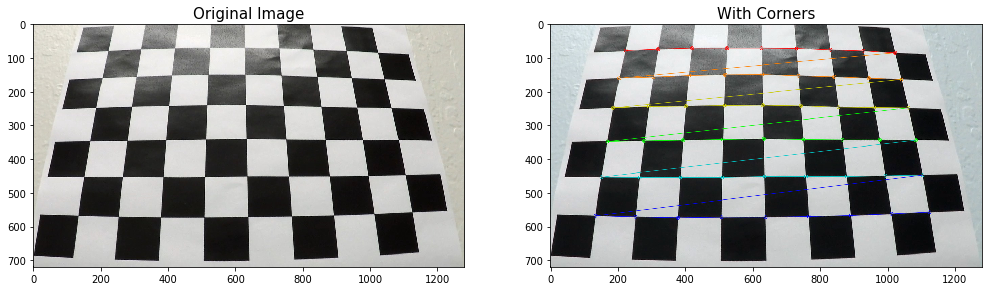

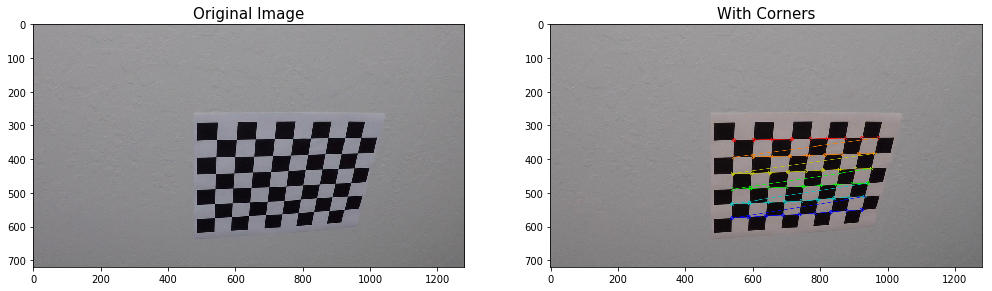

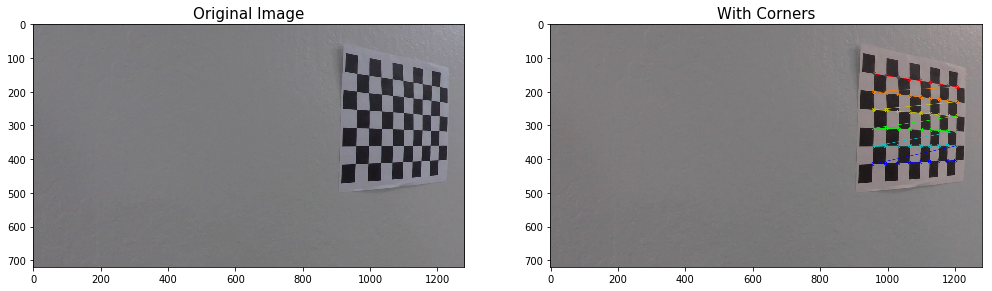

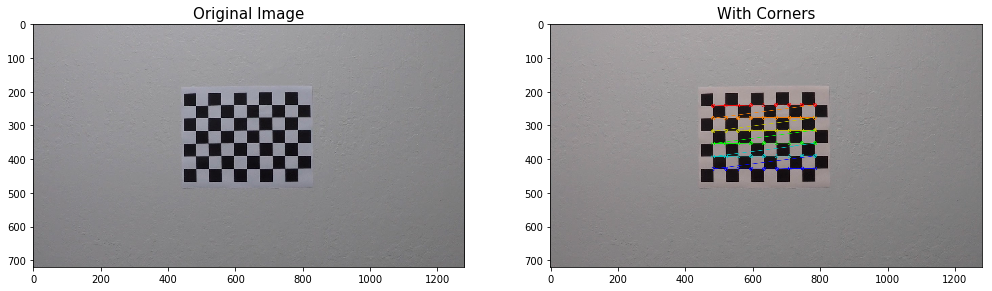

In [190]:
test_img_dir = "camera_cal/"
calibrating_camera(show=True, directory=test_img_dir)

# 3. Correcting for Distortion

The first step in the project is to remove any distortion from the images by calculating the camera calibration matrix and distortion coefficients using a series of images of a chessboard.

In [159]:
# Remove distortion from images
#def undistort(image, objpoints, imgpoints, mtx, dist, rvecs, tvecs, show=False):
def undistort(image, show=False):

    undist = cv2.undistort(image, calibrateCamera[1], calibrateCamera[2], None, calibrateCamera[1])
        
    if show:
        # Plotting images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
        ax1.set_title('Original Image', fontsize=12)
        ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax2.set_title('Undistorted Image', fontsize=12)
        ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
    else:
        return undist

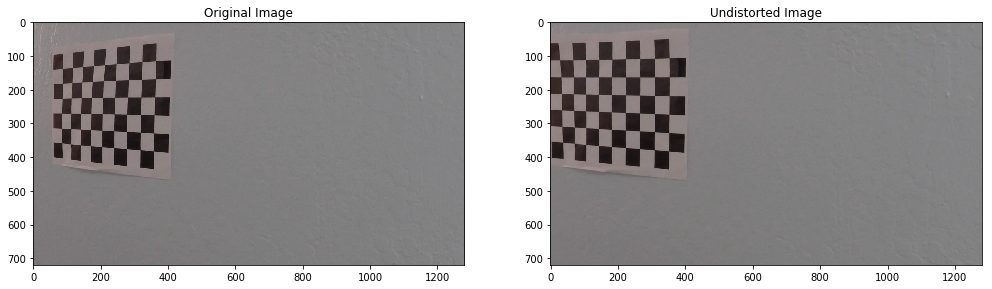

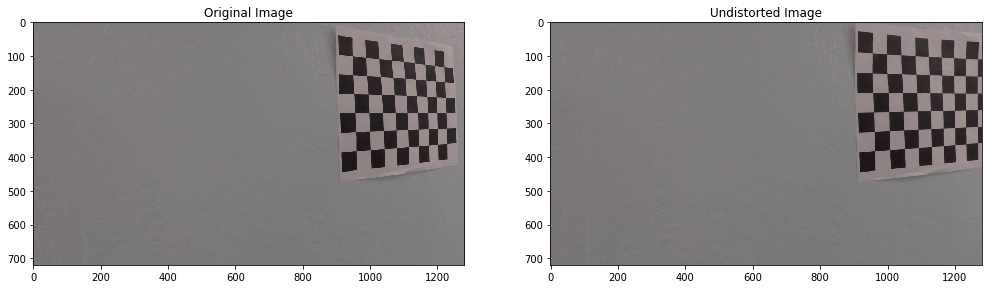

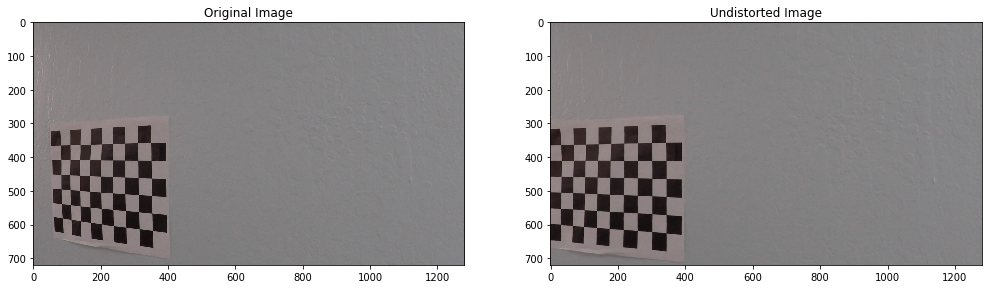

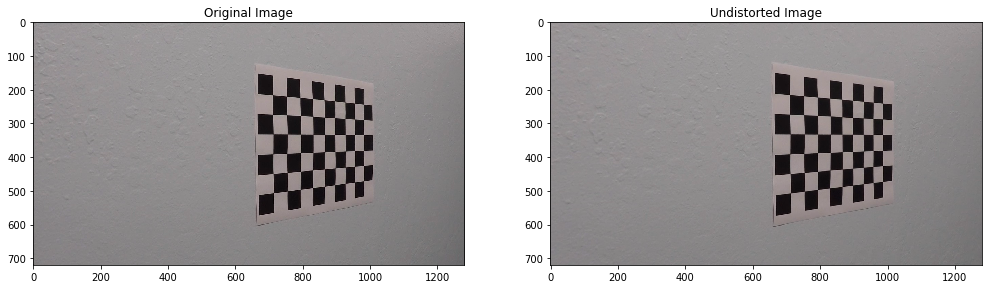

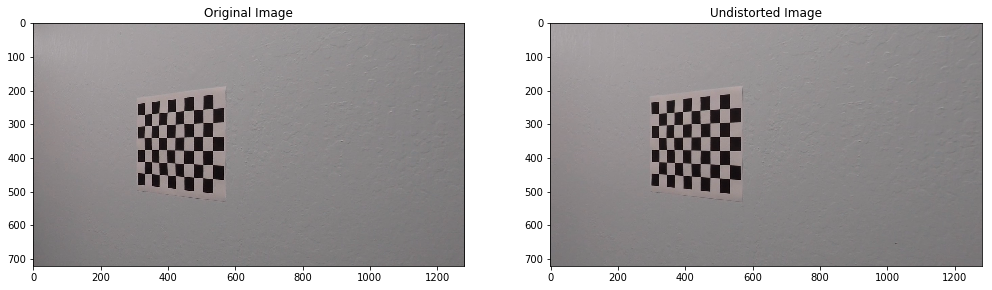

...

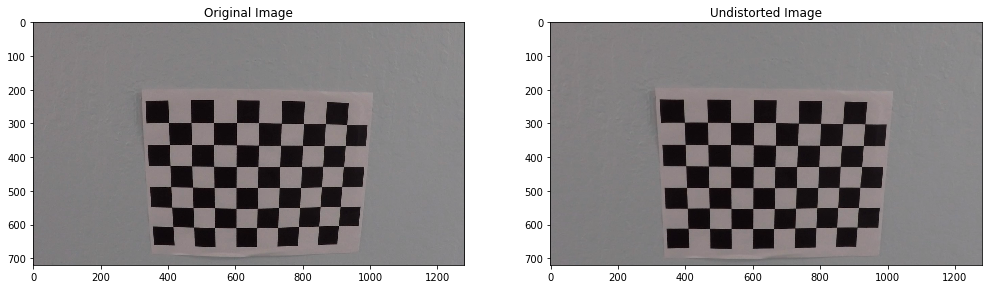

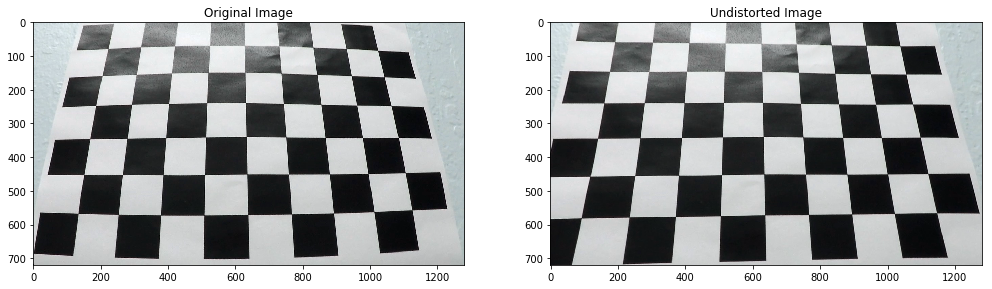

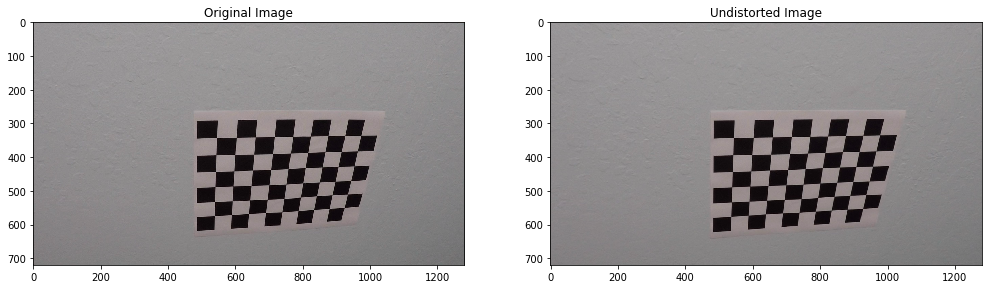

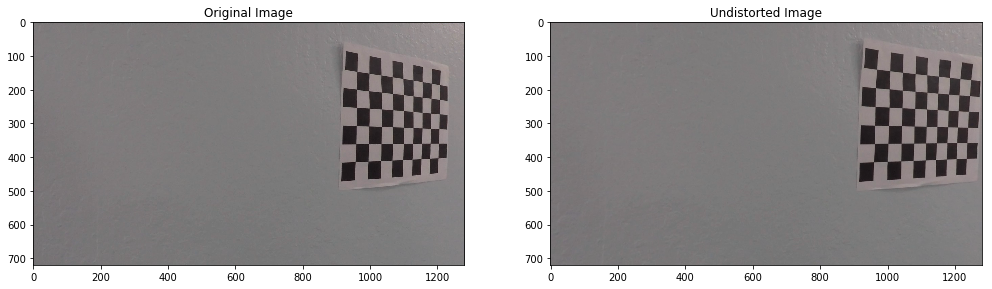

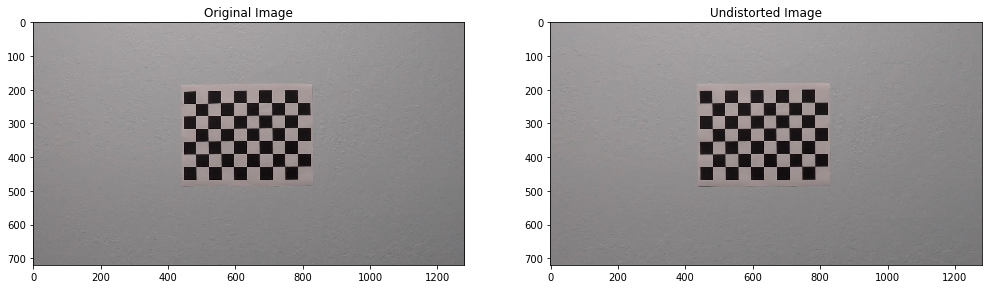

In [191]:
test_img_dir = "camera_cal/"
images = os.listdir(test_img_dir)
images = list(map(lambda name: test_img_dir + name, images))
    
# Display undistored images
for image in images:
    undistort(mpimg.imread(image), show=True )

# 4. Color/gradient threshold

## 4.1 Applying Sobe

Identify pixels where the gradient of an image falls within a specified threshold range.

In [160]:
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x', thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

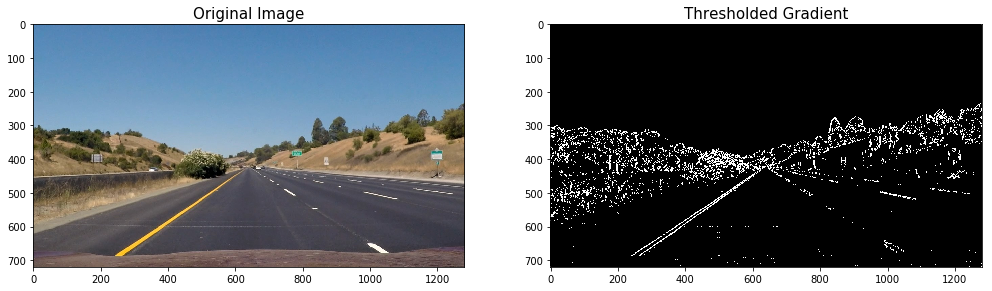

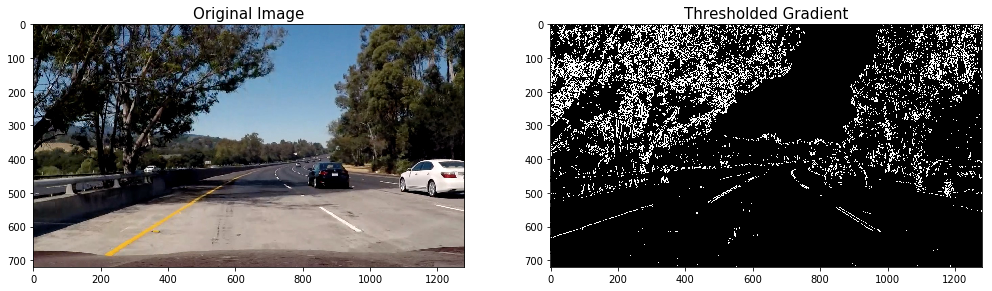

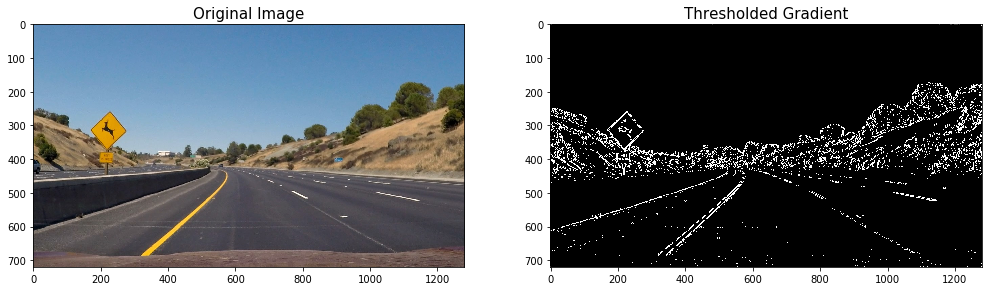

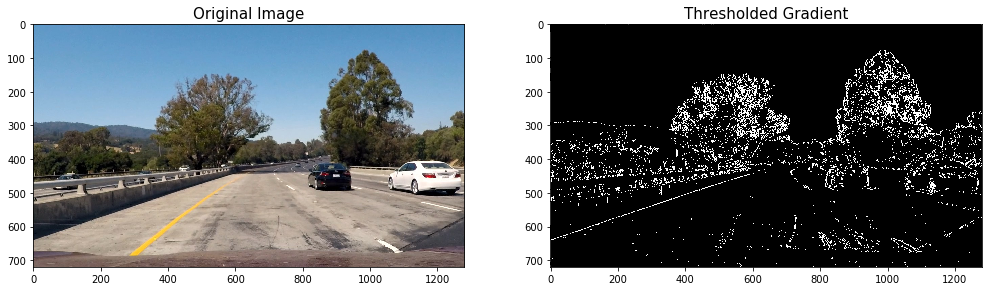

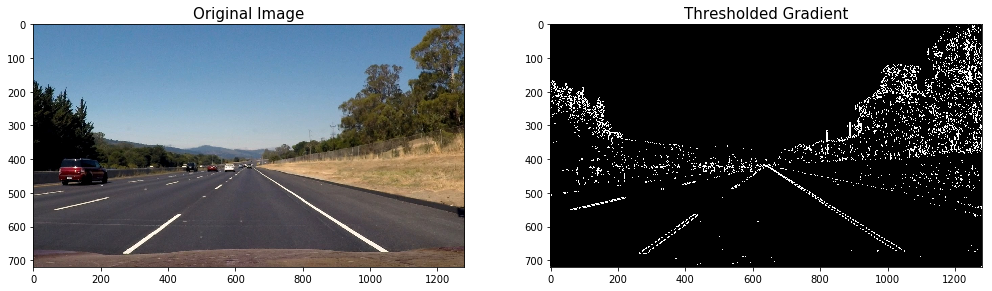

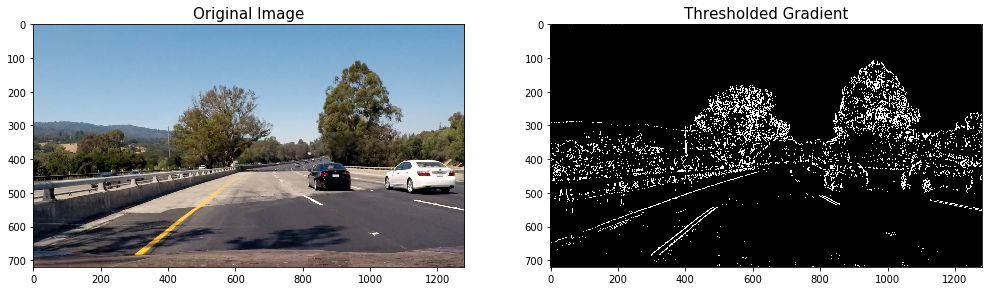

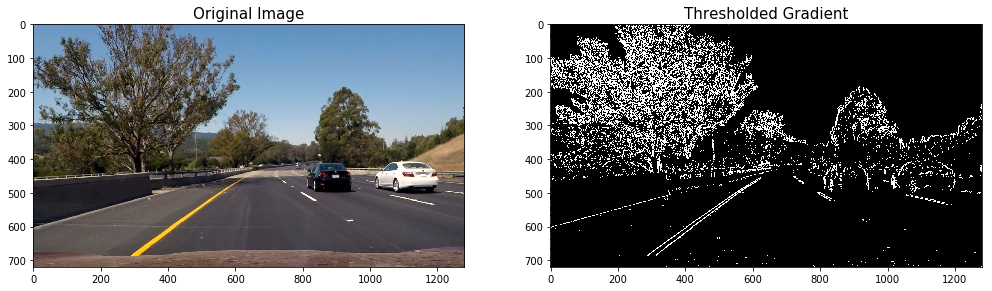

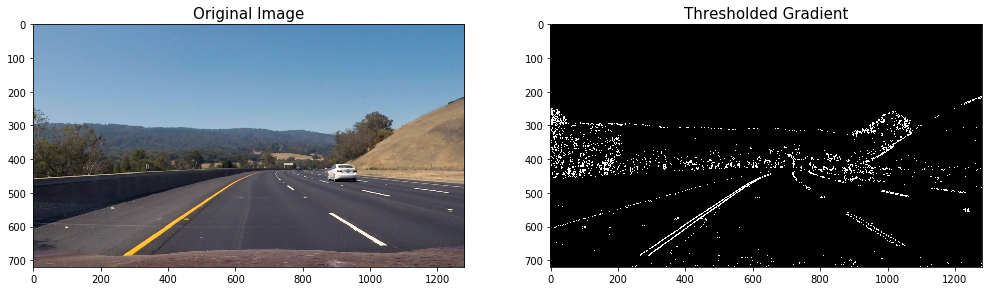

In [192]:
# Making sure we import our images with the right names
test_img_dir = "test_images/"
images = os.listdir(test_img_dir)
images = list(map(lambda name: test_img_dir + name, images))

for image in (images):
    # Run the function
    grad_binary = abs_sobel_thresh(mpimg.imread(image), orient='x', thresh=(20, 100))
    # Plotting images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
    ax1.set_title('Original Image', fontsize=15)
    ax1.imshow(mpimg.imread(image))
    ax2.set_title('Thresholded Gradient', fontsize=15)
    ax2.imshow(grad_binary, cmap='gray')


## 4.2 Magnitude of the Gradient

Get the gradient at x or y and set boundaries to identify pixels within a given gradient range. The x-gradient does a cleaner job of capturing the lane lines, but you can also see the lines in the gradient and.

In [161]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

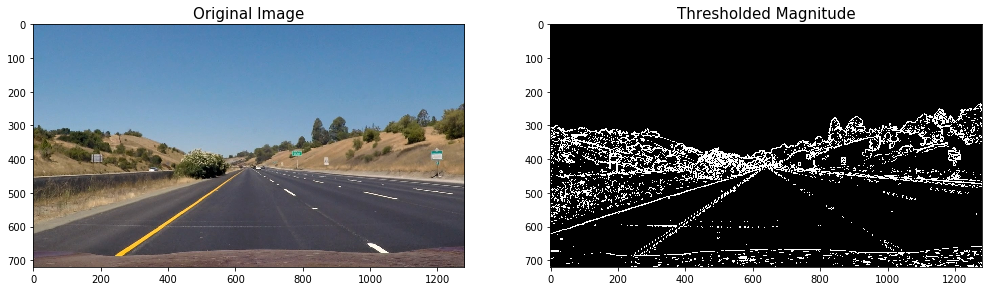

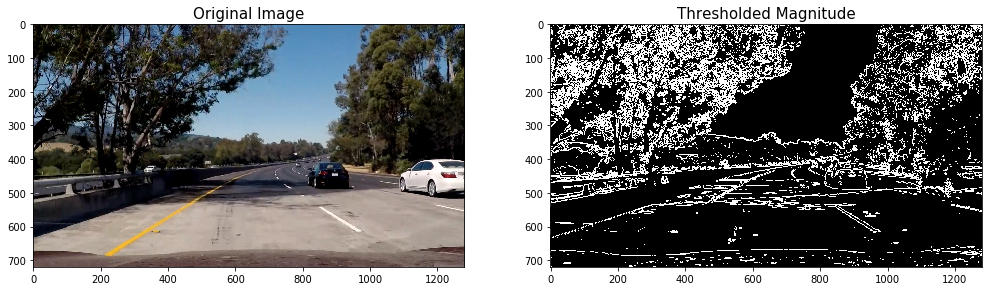

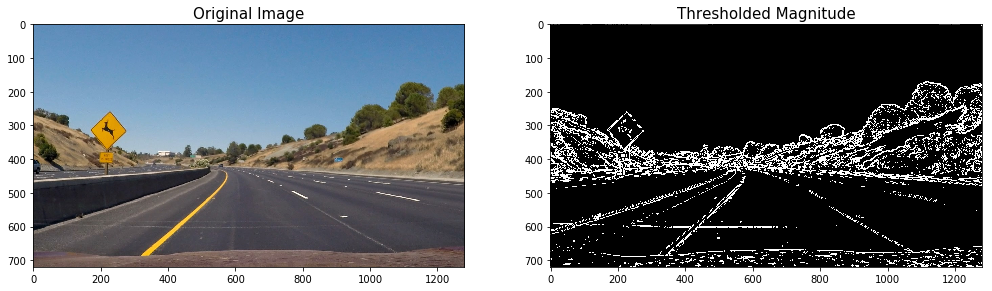

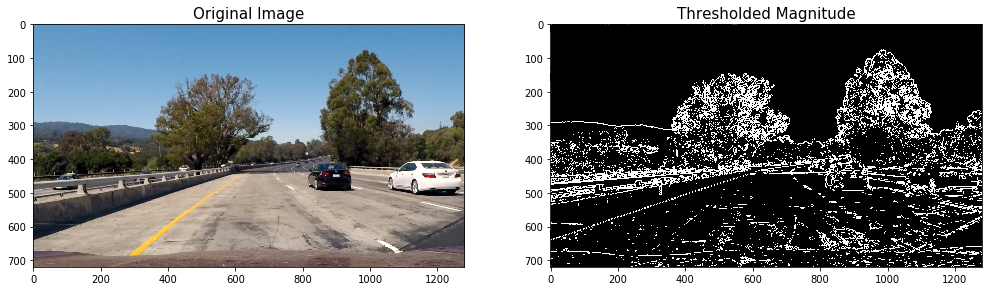

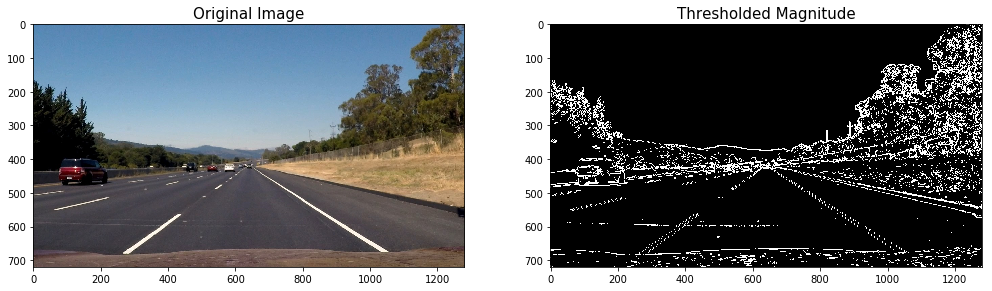

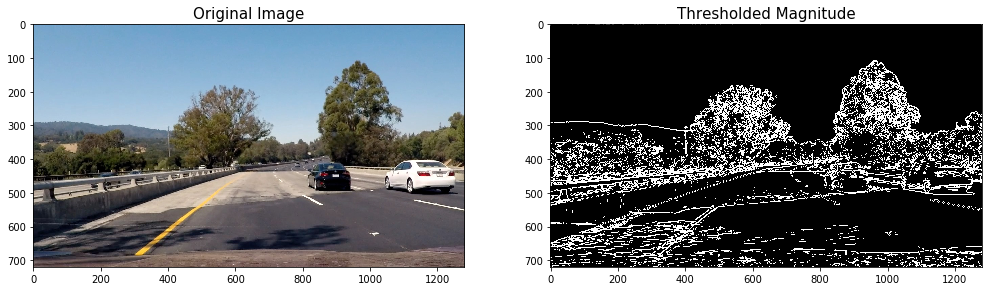

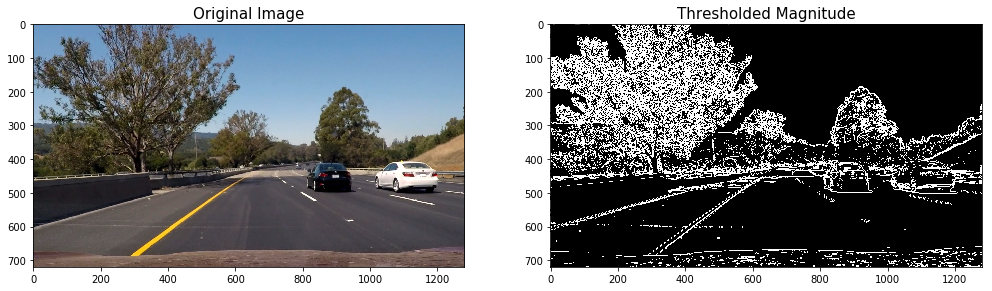

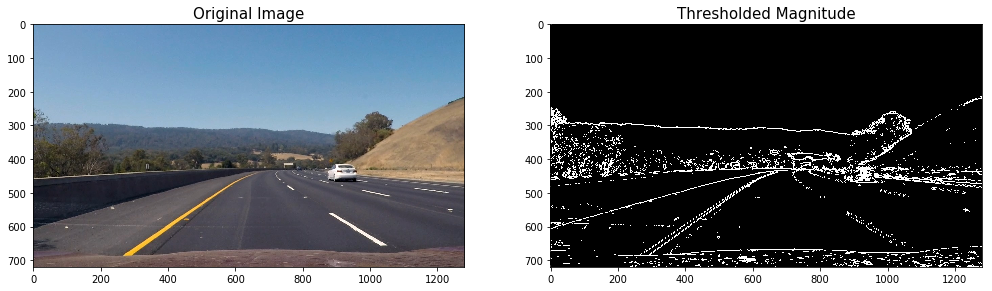

In [193]:
# Display Trehsolded Magnitude Images
for image in (images):
    # Run the function
    mag_binary = mag_thresh(mpimg.imread(image), sobel_kernel=3, mag_thresh=(20, 100))
    # Plotting images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
    ax1.set_title('Original Image', fontsize=15)
    ax1.imshow(mpimg.imread(image))
    ax2.set_title('Thresholded Magnitude', fontsize=15)
    ax2.imshow(mag_binary, cmap='gray')

## 4.3 Direction of the Gradient

When we play around with the thresholding for the gradient magnitude, we find what you might expect, namely, that it picks up the lane lines well, but with a lot of other stuff detected too. Gradient magnitude is at the heart of Canny edge detection, and is why Canny works well for picking up all edges.

In the case of lane lines, we're interested only in edges of a particular orientation. So now we will explore the direction, or orientation, of the gradient.

In [162]:
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

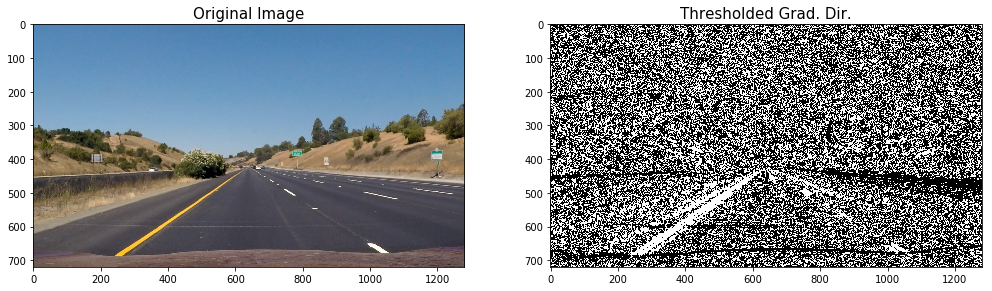

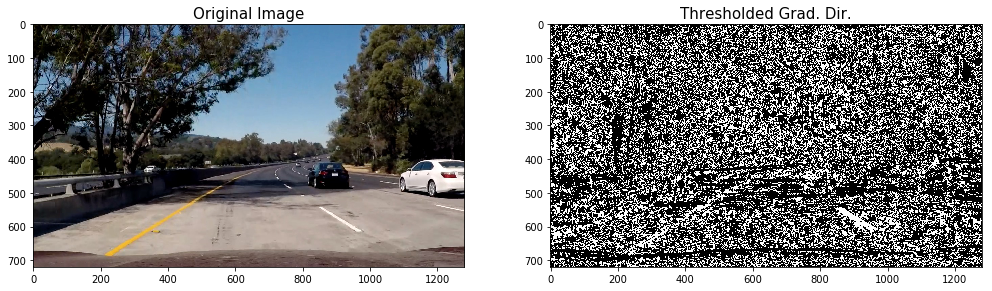

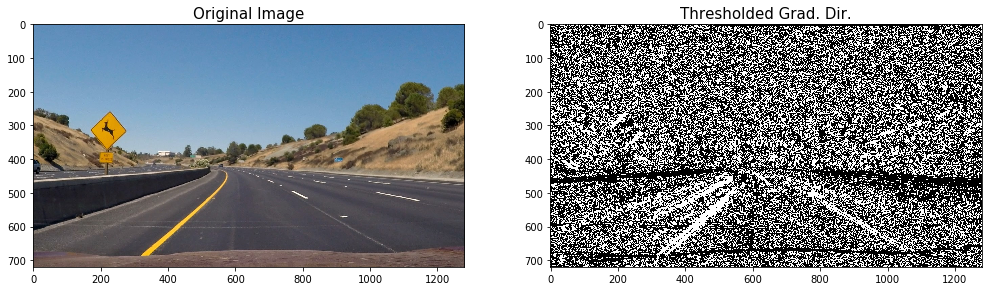

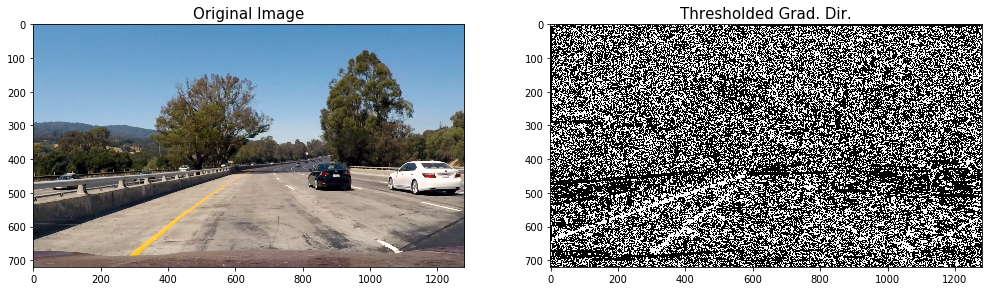

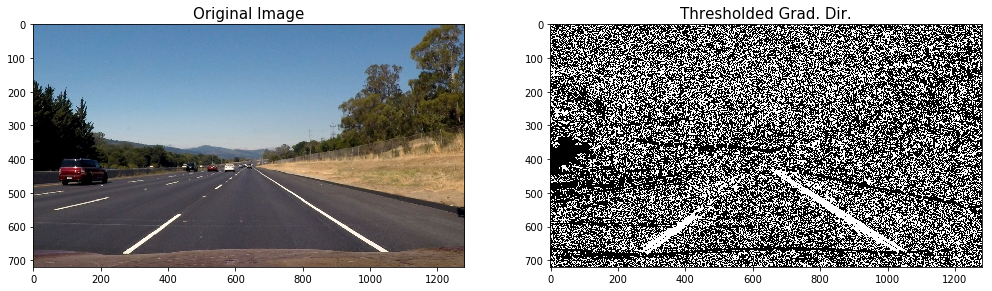

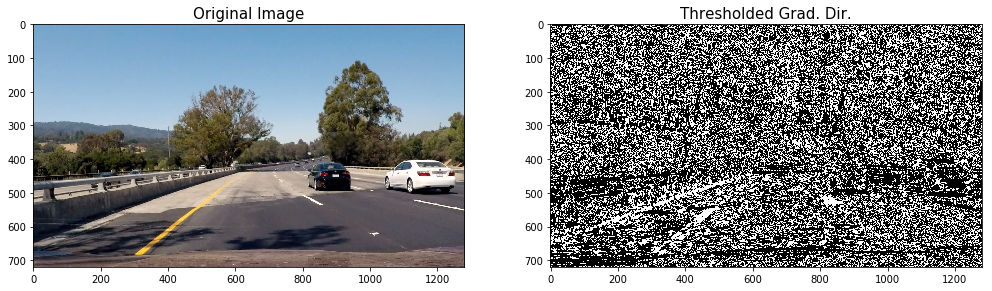

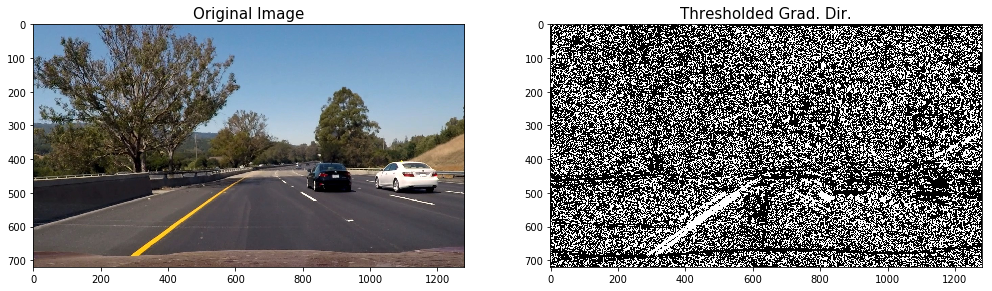

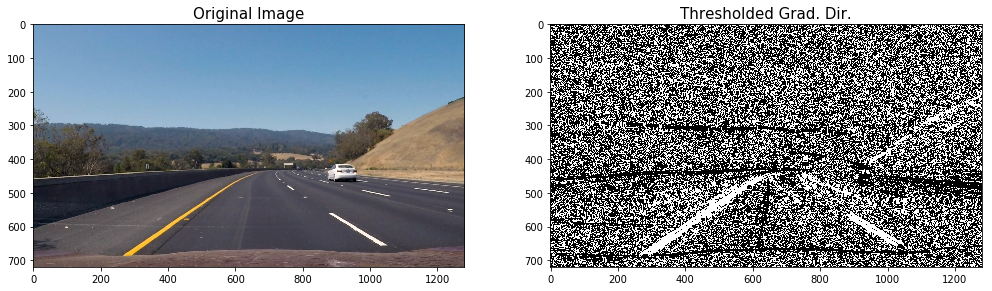

In [194]:
# Display Trehsolded Direction os the Gradient Images
for image in (images):
    # Run the function
    dir_binary = dir_threshold(mpimg.imread(image), sobel_kernel=15, thresh=(0.7, 1.3))
    # Plotting images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
    ax1.set_title('Original Image', fontsize=15)
    ax1.imshow(mpimg.imread(image))
    ax2.set_title('Thresholded Grad. Dir.', fontsize=15)
    ax2.imshow(dir_binary, cmap='gray')

## 4.4 Combining Thresholds

Now consider how we can use various aspects of our gradient measurements (x, y, magnitude, direction) to isolate lane-line pixels. Specifically, we can use thresholds of the x and y gradients, the overall gradient magnitude, and the gradient direction to focus on pixels that are likely to be part of the lane lines.

In [163]:
def combined_thresholds(img, mag_kernel=3, dir_kernel=15, sobel_thresh=(0,255), mg_thresh=(0,255), dir_thresh=(0,255)):

    # Apply each of the thresholding functions
    
    # Applying Sobe
    gradx = abs_sobel_thresh(img, orient='x', thresh=sobel_thresh)
    grady = abs_sobel_thresh(img, orient='y', thresh=sobel_thresh)
    # Magnitude of the Gradient
    mag_binary = mag_thresh(img, sobel_kernel=mag_kernel, mag_thresh=mg_thresh)
    # Direction of the Gradient
    dir_binary = dir_threshold(img, sobel_kernel=dir_kernel, thresh=dir_thresh)

    # apply a threshold, and create a binary image result
    binary_output = np.zeros_like(dir_binary)
    binary_output[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
   
    # Return the binary image
    return binary_output

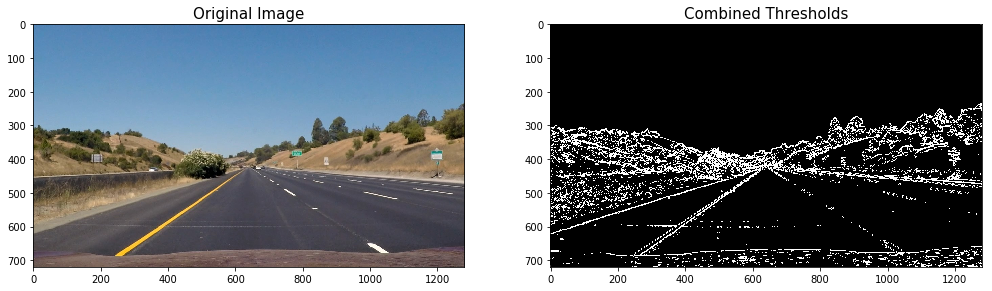

In [195]:
# Display Combined Thresholds Images

# Example image
image = mpimg.imread('test_images/straight_lines1.jpg')
    
# Run the function
combined_thresholds = combined_thresholds(image, mag_kernel=3, dir_kernel=15, sobel_thresh=(10, 100), mg_thresh=(20, 100), dir_thresh=(np.pi/6, np.pi/2))
# Plotting images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
ax1.set_title('Original Image', fontsize=15)
ax1.imshow(image)
ax2.set_title('Combined Thresholds', fontsize=15)
ax2.imshow(combined_thresholds, cmap='gray')

## 4.5 HLS, LUV, LAB Channel and Color Thresholds

Here we'll explore this a bit further to see why a color space like HLS, LUV, LAB Channel can be more robust. Let's first take another look at some of the images.

Here we'll read in the same original image, convert to grayscale, and apply a threshold that identifies the lines.

In [185]:
# Define a function that thresholds the channels (HLS, LUV or LAB)
def color_space(img, thresh_hls=(0, 255), thresh_luv=(0, 255), thresh_lab=(0, 255)):
    
    # Color Space HLS
    cl_space_hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    channel_hls = cl_space_hls[:,:,2] # channel S
    binary_hls = np.zeros_like(channel_hls)
    binary_hls[(channel_hls >= thresh_hls[0]) & (channel_hls <= thresh_hls[1])] = 1
    
    # Color Space LUV
    cl_space_luv = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    channel_luv = cl_space_luv[:,:,0] # channel L
    binary_luv = np.zeros_like(channel_luv)
    binary_luv[(channel_luv >= thresh_luv[0]) & (channel_luv <= thresh_luv[1])] = 1

    # Color Space LAB
    cl_space_lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    channel_lab = cl_space_lab[:,:,2] # channel B
    binary_lab = np.zeros_like(channel_lab)
    binary_lab[(channel_lab >= thresh_lab[0]) & (channel_lab <= thresh_lab[1])] = 1

    # Combined HLS, LUV and LAB
    combined_channel = np.zeros_like(channel_hls)
    combined_channel[(channel_luv == 1) | (channel_lab == 1)] = 1
    combined_binary = np.zeros_like(binary_hls)
    combined_binary[(binary_luv == 1) | (binary_lab == 1)] = 1


    return channel_hls, channel_luv, channel_lab, combined_channel, binary_hls, binary_luv, binary_lab, combined_binary

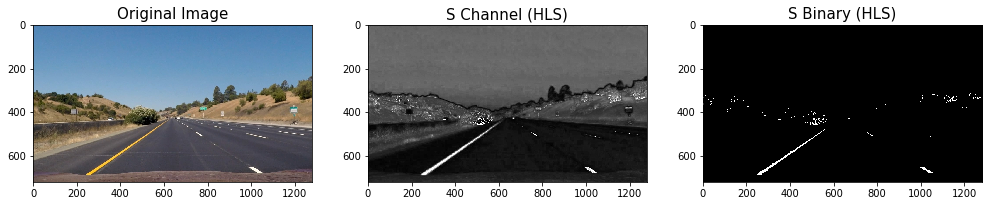

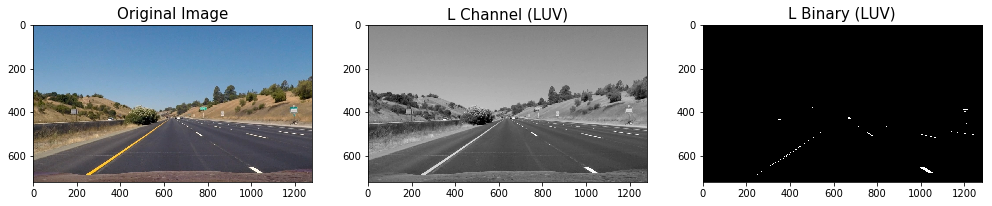

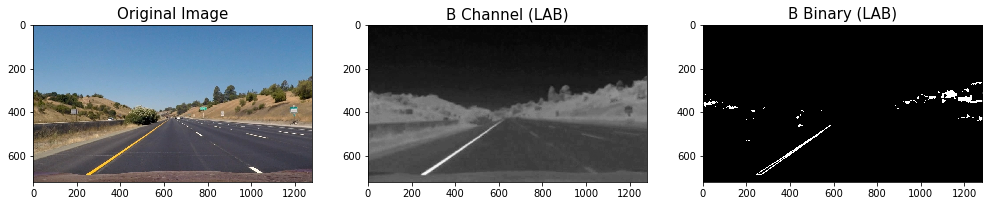

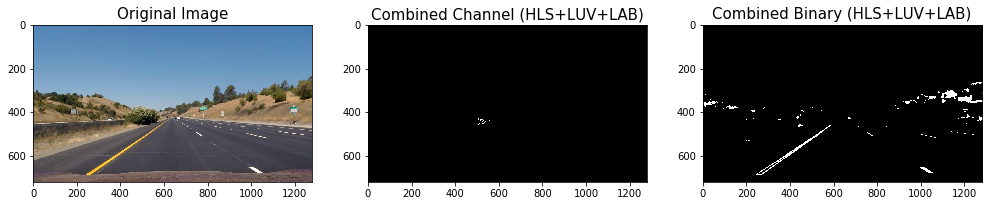

In [196]:
# Display HLS, LUV and LAB Channel and Binary Images

# Example image
image = mpimg.imread('test_images/straight_lines1.jpg')
    
# Run the function
colorspace = color_space(image, thresh_hls=(170, 255), thresh_luv=(215, 255), thresh_lab=(155, 200))

# Plotting S Channel image (HLS)
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(17,10))
ax1.set_title('Original Image', fontsize=15)
ax1.imshow(image)
ax2.set_title('S Channel (HLS)', fontsize=15)
ax2.imshow(colorspace[0], cmap='gray')
ax3.set_title('S Binary (HLS)', fontsize=15)
ax3.imshow(colorspace[4], cmap='gray')

# Plotting L Channel image (LUV)
f, (ay1, ay2, ay3) = plt.subplots(1, 3, figsize=(17,10))
ay1.set_title('Original Image', fontsize=15)
ay1.imshow(image)
ay2.set_title('L Channel (LUV)', fontsize=15)
ay2.imshow(colorspace[1], cmap='gray')
ay3.set_title('L Binary (LUV)', fontsize=15)
ay3.imshow(colorspace[5], cmap='gray')

# Plotting B Channel image (LAB)
f, (az1, az2, az3) = plt.subplots(1, 3, figsize=(17,10))
az1.set_title('Original Image', fontsize=15)
az1.imshow(image)
az2.set_title('B Channel (LAB)', fontsize=15)
az2.imshow(colorspace[2], cmap='gray')
az3.set_title('B Binary (LAB)', fontsize=15)
az3.imshow(colorspace[6], cmap='gray')

# Plotting Combined Channel image (HLS+LUV+LAB)
f, (aa1, aa2, aa3) = plt.subplots(1, 3, figsize=(17,10))
aa1.set_title('Original Image', fontsize=15)
aa1.imshow(image)
aa2.set_title('Combined Channel (HLS+LUV+LAB)', fontsize=15)
aa2.imshow(colorspace[3], cmap='gray')
aa3.set_title('Combined Binary (HLS+LUV+LAB)', fontsize=15)
aa3.imshow(colorspace[7], cmap='gray')

## 4.6 Color and Gradient

To combine what we know about color and gradient thresholding to get the best of both worlds.

At this point, it's okay to detect edges around trees or cars because these lines can be mostly filtered out by applying a mask to the image and essentially cropping out the area outside of the lane lines. It's most important that we reliably detect different colors of lane lines under varying degrees of daylight and shadow.

We can clearly see which parts of the lane lines were detected by the gradient threshold and which parts were detected by the color threshold by stacking the channels and seeing the individual components. We can create a binary combination of these two images to map out where either the color or gradient thresholds were met. Together, we applied the region of interest mask.

In [165]:
# Create a masked edges image
def masked_edges_image(img):
    
    imshape = img.shape
     
    p1 = (0.0,imshape[0]) 
    p2 = (0.48*imshape[1], 0.61*imshape[0]) #61
    p23 = (0.5*imshape[1],p2[1])
    p241 = (p23[0]-1.3*p1[0],p1[1])
    p242 = (p23[0]+1.3*p1[0],p1[1])
    p3 = (0.55*imshape[1], p2[1]) #57
    p4 = (imshape[1],imshape[0])
    vertices = np.array([[p1,p2,p3,p4]], dtype=np.int32) # Road ROI
    
    return vertices

In [166]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    
    return masked_image

In [167]:
# Region Of Interest Mask
def region_interest_mark(img):

    # Using Canny and color selection
    vertices = masked_edges_image(img)
    img_masked = region_of_interest(img, vertices)

    return img_masked

In [168]:
def get_thresholded_image(img):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    image = undistort(img, show=False)   

    # convert to gray scale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    height, width = gray.shape
    
    # Threshold x gradient
    sxbinary = abs_sobel_thresh((image), orient='x', thresh=(20, 100))
    
    # Threshold combined color channel (HLS+LUV+LAB)
    combined_channel_binary = color_space(image, thresh_hls=(170, 255), thresh_luv=(215, 255), thresh_lab=(155, 200))

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, combined_channel_binary[7])) * 255

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(combined_channel_binary[7] == 1) | (sxbinary == 1)] = 1
    
    # apply the region of interest mask
    thresholded = region_interest_mark(combined_binary)

    return color_binary, combined_binary, thresholded

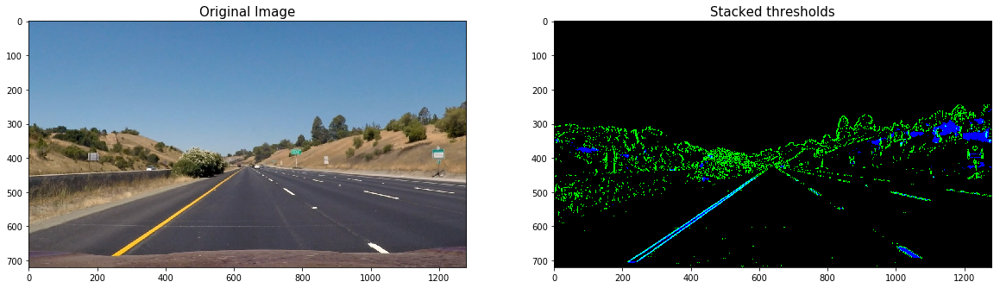

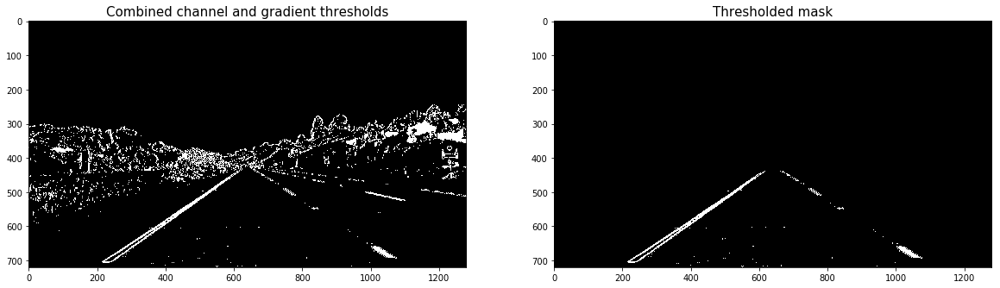

In [197]:
# Display Stacked tresholds, Combined Channel and gradient tresholds, Thresholded region mask Images

# Example Image
img = 'test_images/straight_lines1.jpg'

# Run the function
thresholded_image = get_thresholded_image(mpimg.imread(img))

# Plotting thresholded images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Original Image', fontsize=15)
ax1.imshow(mpimg.imread(img))
ax2.set_title('Stacked thresholds', fontsize=15)
ax2.imshow(thresholded_image[0]) # Color Binary

f, (ay1, ay2) = plt.subplots(1, 2, figsize=(20,10))
ay1.set_title('Combined channel and gradient thresholds', fontsize=15)
ay1.imshow(thresholded_image[1], cmap='gray') # Combined Image
ay2.set_title('Thresholded mask', fontsize=15)
ay2.imshow(thresholded_image[2], cmap='gray') # Combined Image Mask

# 5 Perspective Transform

After manually examining a sample image, we extracted the vertices to perform a perspective transform. The polygon with these vertices is drawn on the image for visualization. Destination points are chosen such that straight lanes appear more or less parallel in the transformed image.

The transform and its inverse are computer, for use later. We then transform the binary image.

In [169]:
def perspective_tranform(img, thresholded):
    # Vertices extracted manually for performing a perspective transform
    top_left = [585, 455]
    top_right = [700, 455]
    bottom_left = [255,680]        
    bottom_right = [1055, 680]   
    source = np.float32([bottom_left,bottom_right,top_right,top_left])
    
    pts = np.array([bottom_left,bottom_right,top_right,top_left], np.int32)
    pts = pts.reshape((-1,1,2))
    new_img = img.copy()
    cv2.polylines(new_img,[pts],True,(255,0,0), thickness=3)

    # Destination points are chosen such that straight lanes appear more or less parallel in the transformed image.
    top_left = [320, 1]
    top_right = [920, 1]
    bottom_left = [320,680]
    bottom_right = [920, 680]
    dst = np.float32([bottom_left,bottom_right,top_right,top_left])
   
    M = cv2.getPerspectiveTransform(source, dst)
    Minv = cv2.getPerspectiveTransform(dst, source)
    img_shape = img.shape
    img_size = (img_shape[1], img_shape[0])
    
    warped = cv2.warpPerspective(thresholded, M, img_size , flags=cv2.INTER_LINEAR)

    return warped, M, Minv, img_size, new_img

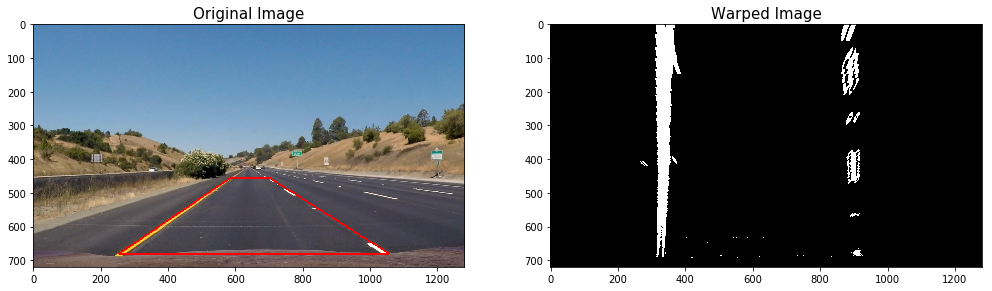

In [198]:
# Display Warped Image

# Example Image
img = mpimg.imread('test_images/straight_lines1.jpg')

# Run the function
perspective_tranform_img = perspective_tranform(img, thresholded_image[2])

# Plotting images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(17,10))
ax1.set_title('Original Image', fontsize=15)
ax1.imshow(perspective_tranform_img[4])
ax2.set_title('Warped Image', fontsize=15)
ax2.imshow(perspective_tranform_img[0], cmap='gray')

# 6 Locate the Lane Lines

## 6.1 Peaks in a Histogram

After applying calibration, thresholding, and a perspective transform to a road image, we should have a binary image where the lane lines stand out clearly. However, we still need to decide explicitly which pixels are part of the lines and which belong to the left line and which belong to the right line.

Plotting a histogram of where the binary activations occur across the image is one potential solution for this.

In [170]:
def hist(img):
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # Sum across image pixels vertically - make sure to set an `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
    
    # Peak in the first half indicates the likely position of the left lane
    half_width = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:half_width])

    # Peak in the second half indicates the likely position of the right lane
    rightx_base = np.argmax(histogram[half_width:]) + half_width
    
    return histogram, leftx_base, rightx_base

334 905


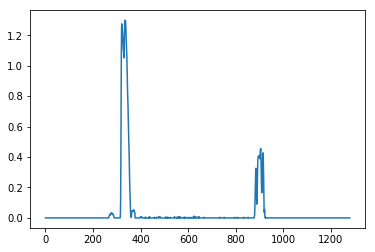

In [199]:
# Load our image
# `mpimg.imread` will load .jpg as 0-255, so normalize back to 0-1
img = perspective_tranform_img[0]/255

# Create histogram of image binary activations
histogram, leftx_base, rightx_base = hist(img)

# Visualize the resulting histogram
print(leftx_base, rightx_base)
plt.plot(histogram)


## 6.2 Sliding Window

I then perform a sliding window search, starting with the base likely positions of the 2 lanes, calculated from the histogram. I have used 10 windows of width 100 pixels.

The x & y coordinates of non zeros pixels are found, a polynomial is fit for these coordinates and the lane lines are drawn.

We can use the two highest peaks from our histogram as a starting point for determining where the lane lines are, and then use sliding windows moving upward in the image (further along the road) to determine where the lane lines go.

In [172]:
leftx_base=None
rightx_base=None
polyfit_left=None
polyfit_right=None
left_x_predictions=None
right_x_predictions=None
    
def sliding_window(warped):

    global leftx_base
    global rightx_base
    global polyfit_left
    global polyfit_right
    global left_x_predictions
    global right_x_predictions
        
    histogram, leftx_base, rightx_base = hist(warped/255)
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((warped, warped, warped))*255

    # Identify the x and y positions of all nonzero (i.e. activated) pixels in the image
    non_zeros = warped.nonzero()
    non_zeros_y = non_zeros[0]
    non_zeros_x = non_zeros[1]

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    num_windows = 10
    
    # Set height of windows - based on nwindows above and image shape
    num_rows = warped.shape[0]
    window_height = np.int(num_rows/num_windows)
    window_half_width = 50

    # Set minimum number of pixels found to recenter windows
    min_pixels = 100

    # Create empty lists to receive left and right lane pixel indices
    left_coordinates = []
    right_coordinates = []

    for window in range(num_windows):
        y_max = num_rows - window*window_height
        y_min = num_rows - (window+1)* window_height

        left_x_min = leftx_base - window_half_width
        left_x_max = leftx_base + window_half_width

        # Left Rectangle    
        cv2.rectangle(out_img, (left_x_min, y_min), (left_x_max, y_max), [0,255,0],2)

        good_left_window_coordinates = ((non_zeros_x >= left_x_min) & (non_zeros_x <= left_x_max) & (non_zeros_y >= y_min) & (non_zeros_y <= y_max)).nonzero()[0]
        left_coordinates.append(good_left_window_coordinates)

        if len(good_left_window_coordinates) > min_pixels:
            leftx_base = np.int(np.mean(non_zeros_x[good_left_window_coordinates]))

        right_x_min = rightx_base - window_half_width
        right_x_max = rightx_base + window_half_width

        # Right Rectangle    
        cv2.rectangle(out_img, (right_x_min, y_min), (right_x_max, y_max), [0,255,0],2)

        good_right_window_coordinates = ((non_zeros_x >= right_x_min) & (non_zeros_x <= right_x_max) & (non_zeros_y >= y_min) & (non_zeros_y <= y_max)).nonzero()[0]
        right_coordinates.append(good_right_window_coordinates)

        if len(good_right_window_coordinates) > min_pixels:
            rightx_base = np.int(np.mean(non_zeros_x[good_right_window_coordinates]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    left_coordinates = np.concatenate(left_coordinates)
    right_coordinates = np.concatenate(right_coordinates)
    
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[non_zeros_y[left_coordinates], non_zeros_x[left_coordinates]] = [255,0,0]
    out_img[non_zeros_y[right_coordinates], non_zeros_x[right_coordinates]] = [0,0,255]

    # Extract left and right line pixel positions
    left_x = non_zeros_x[left_coordinates]
    left_y = non_zeros_y[left_coordinates]
    right_x = non_zeros_x[right_coordinates]
    right_y = non_zeros_y[right_coordinates]

    # Assuming we have `left_fit` and `right_fit` from `np.polyfit` before
    # Generate x and y values for plotting
    left_fit, right_fit = (None, None)
    # Fit a second order polynomial to each
    if len(left_x) != 0:
        polyfit_left = np.polyfit(left_y, left_x, 2)
    if len(right_x) != 0:        
        polyfit_right = np.polyfit(right_y, right_x, 2)
    
    y_points = np.linspace(0, num_rows-1, num_rows)
    left_x_predictions = polyfit_left[0]*y_points**2 + polyfit_left[1]*y_points + polyfit_left[2]
    right_x_predictions = polyfit_right[0]*y_points**2 + polyfit_right[1]*y_points + polyfit_right[2]

    return out_img, left_x_predictions, right_x_predictions, y_points, polyfit_left, polyfit_right, non_zeros_x, non_zeros_y, num_rows


(720, 0)

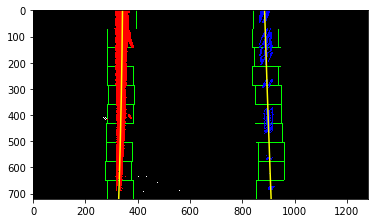

In [200]:
# Run the function
sliding_win = sliding_window(perspective_tranform_img[0])    

# Plotting image
plt.imshow(sliding_win[0])
plt.plot(sliding_win[1], sliding_win[3], color='yellow')
plt.plot(sliding_win[2], sliding_win[3], color='yellow')
plt.xlim(0, sliding_win[0].shape[1])
plt.ylim(sliding_win[0].shape[0],0)

## 6.3 Search from Prior

Using the full algorithm from before and starting fresh on every frame may seem inefficient, as the lines don't necessarily move a lot from frame to frame.

We need to do a blind search again, but instead you can just search in a margin around the previous line position, like in the above image. The green shaded area shows where we searched for the lines this time. So, once we know where the lines are in one frame of video, we can do a highly targeted search for them in the next frame.

This is equivalent to using a customized region of interest for each frame of video, and should help us track the lanes through sharp curves and tricky conditions. 

In [174]:
# Some global variables
polyfit_left=None
polyfit_right=None

def search_from_prior(warped, sliding_win):

    global polyfit_left
    global polyfit_right
    
    # Create an image to draw on and an image to show the selection window
    margin = 50
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((warped, warped, warped))*255

    # Set height of windows - based on nwindows above and image shape
    num_rows = sliding_win[8]
    
    # Identify the x and y positions of all nonzero (i.e. activated) pixels in the image
    non_zeros = warped.nonzero()
    non_zeros_x = sliding_win[6]
    non_zeros_y = sliding_win[7]    
    
    polyfit_left = sliding_win[4]
    polyfit_right = sliding_win[5]
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_x_predictions = polyfit_left[0]*non_zeros_y**2 + polyfit_left[1]*non_zeros_y + polyfit_left[2]
    left_coordinates = ((non_zeros_x >= left_x_predictions - margin) & (non_zeros_x <= left_x_predictions + margin)).nonzero()[0]
    right_x_predictions = polyfit_right[0]*non_zeros_y**2 + polyfit_right[1]*non_zeros_y + polyfit_right[2]
    right_coordinates = ((non_zeros_x >= right_x_predictions - margin) & (non_zeros_x <= right_x_predictions + margin)).nonzero()[0]

    # Color in left and right line pixels
    out_img[non_zeros_y[left_coordinates], non_zeros_x[left_coordinates]] = [255,0,0]
    out_img[non_zeros_y[right_coordinates], non_zeros_x[right_coordinates]] = [0,0,255]

    # Again, extract left and right line pixel positions
    left_x = non_zeros_x[left_coordinates]
    left_y = non_zeros_y[left_coordinates]
    right_x = non_zeros_x[right_coordinates]
    right_y = non_zeros_y[right_coordinates]

    # Fit a second order polynomial to each with np.polyfit()
    # Generate x and y values for plotting
    polyfit_left = np.polyfit(left_y, left_x, 2)
    polyfit_right = np.polyfit(right_y, right_x, 2)
    y_points = np.linspace(0, num_rows-1, num_rows)
    left_x_predictions = polyfit_left[0]*y_points**2 + polyfit_left[1]*y_points + polyfit_left[2]
    right_x_predictions = polyfit_right[0]*y_points**2 + polyfit_right[1]*y_points + polyfit_right[2]

    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    window_img = np.zeros_like(out_img)

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window_1 = np.array(np.transpose(np.vstack([left_x_predictions - margin, y_points])))
    left_line_window_2 = np.array(np.flipud(np.transpose(np.vstack([left_x_predictions + margin, y_points]))))
    left_line_points = np.vstack((left_line_window_1, left_line_window_2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_points]), [0,255, 0])
    right_line_window_1 = np.array(np.transpose(np.vstack([right_x_predictions - margin, y_points])))
    right_line_window_2 = np.array(np.flipud(np.transpose(np.vstack([right_x_predictions + margin, y_points]))))
    right_line_points = np.vstack((right_line_window_1, right_line_window_2))
    cv2.fillPoly(window_img, np.int_([right_line_points]), [0,255, 0])

    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return result, left_x_predictions, right_x_predictions, y_points, num_rows


(720, 0)

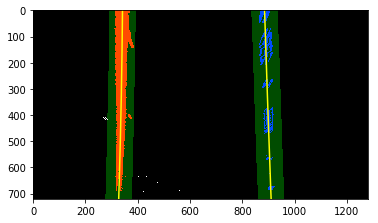

In [201]:
# Plot the polynomial lines onto the image

# Run the function
search_prior = search_from_prior(perspective_tranform_img[0], sliding_win)

# Plotting images
plt.imshow(search_prior[0])
plt.plot(search_prior[1], search_prior[3], color='yellow')
plt.plot(search_prior[2], search_prior[3], color='yellow')
plt.xlim(0, search_prior[0].shape[1])
plt.ylim(search_prior[0].shape[0],0)

# 7 Determine the lane curvature

We have a thresholded image, where we've estimated which pixels belong to the left and right lane lines (shown in red and blue, respectively, above), and you've fit a polynomial to those pixel positions. Next we'll compute the radius of curvature of the fit.

In [175]:
def measure_curvature_pixels(x_values, num_rows):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # If no pixels were found return None
    y_points = np.linspace(0, num_rows-1, num_rows)
    y_eval = np.max(y_points)

    # Fit new polynomials to x,y in world space
    fit_cr = np.polyfit(y_points*ym_per_pix, x_values*xm_per_pix, 2)
    curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
    
    return curverad

In [176]:
def print_radius_curvature_center_offset(warped, img_size, search_prior):
    # Print Radius of curvature
    left_x_predictions = search_prior[1]
    right_x_predictions = search_prior[2]

    left_curve_rad = measure_curvature_pixels(left_x_predictions, search_prior[4])
    right_curve_rad = measure_curvature_pixels(right_x_predictions, search_prior[4])
    average_curve_rad = (left_curve_rad + right_curve_rad)/2
    curvature_string = "Radius of curvature: %.2f m" % average_curve_rad
    #print(curvature_string)

    # Print compute the offset from the center
    lane_center = (right_x_predictions[719] + left_x_predictions[719])/2
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    center_offset_pixels = abs(img_size[0]/2 - lane_center)
    center_offset_mtrs = xm_per_pix*center_offset_pixels
    offset_string = "Center offset: %.2f m" % center_offset_mtrs
    #print(offset_string)
    
    return curvature_string, offset_string

In [148]:
# Print Radius and Center offset
perspective_transform = perspective_tranform(img, thresholded_image[2])
curvature_string, offset_string = print_radius_curvature_center_offset(perspective_transform[0], perspective_transform[3], search_prior)
print(curvature_string)
print(offset_string)

Radius of curvature: 29589.82 m
Center offset: 0.11 m


# 8 Inverse Transform

In this block of code we:
    * Paint the lane area
    * Perform an inverse perspective transform
    * Combine the precessed image with the original image.

In [177]:
def inverse_transform(original_img, warped, Minv, img_size, search_prior):

    new_img = np.copy(original_img)

    # Create an image to draw the lines on    
    out_img = np.dstack((warped, warped, warped))*255
    
    num_rows = search_prior[4]
    points = np.linspace(0, num_rows-1, num_rows) # to cover same y-range as image

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([search_prior[1], points]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([search_prior[2], points])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(out_img, np.int_([pts]), [0,255, 0])
    cv2.polylines(out_img, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(out_img, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    unwarped = cv2.warpPerspective(out_img, Minv, img_size , flags=cv2.INTER_LINEAR)
    
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, unwarped, 0.5, 0)
    
    return result 

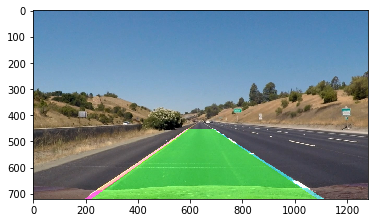

In [202]:
# Example Image
img = mpimg.imread('test_images/straight_lines1.jpg')

# Run the function
perspective_tranform_img = perspective_tranform(img, thresholded_image[2])
inverse_transform_img = inverse_transform(img, perspective_tranform_img[0], perspective_tranform_img[2], perspective_tranform_img[3], search_prior)
# plot the image
plt.imshow(inverse_transform_img)

# 9 Pipeline

Build the pipeline and run your solution.

## 9.1 Processing Images

Consolidated function to call the other functions to perform the image processing required for video generation.

In [179]:
def processing_pipeline_image(img):

    # Color/gradient threshold
    thresholded_image = get_thresholded_image(img)
    
    # Perspective transform
    warped, M, Minv, img_size, new_img = perspective_tranform(img, thresholded_image[2])

    # Peaks in a Histogram
    # Create histogram of image binary activations
    histogram, half_width, leftx_base = hist(warped/255)
    
    # Sliding Window
    sliding_win = sliding_window(warped)
    
    # Search from Prior
    search_prior = search_from_prior(warped, sliding_win)

    # Measuring Curvature   
    curvature_string, offset_string = print_radius_curvature_center_offset(warped, img_size, search_prior)
    
    # Inverse transform
    inverse_transform_img = inverse_transform(img, warped, Minv, img_size, search_prior)
   
    # Result
    cv2.putText(inverse_transform_img,curvature_string , (100, 90), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), thickness=2)
    cv2.putText(inverse_transform_img, offset_string, (100, 150), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), thickness=2)
    
    return inverse_transform_img

## 9.2 Test on Images

In [180]:
# function for reset the global variable
def reset_prev():    
    global objpoints
    global imgpoints
    global leftx_base
    global rightx_base
    global polyfit_left
    global polyfit_right
    global left_x_predictions
    global right_x_predictions
    global calibrateCamera

    objpoints = None
    imgpoints = None
    leftx_base = None
    rightx_base = None
    polyfit_left = None
    polyfit_right = None
    left_x_predictions = None
    right_x_predictions = None    
    calibrateCamera = None

Processing image: straight_lines1.jpg
Processing image: test5.jpg
Processing image: test2.jpg
Processing image: test1.jpg
Processing image: straight_lines2.jpg
Processing image: test4.jpg
Processing image: test6.jpg
Processing image: test3.jpg


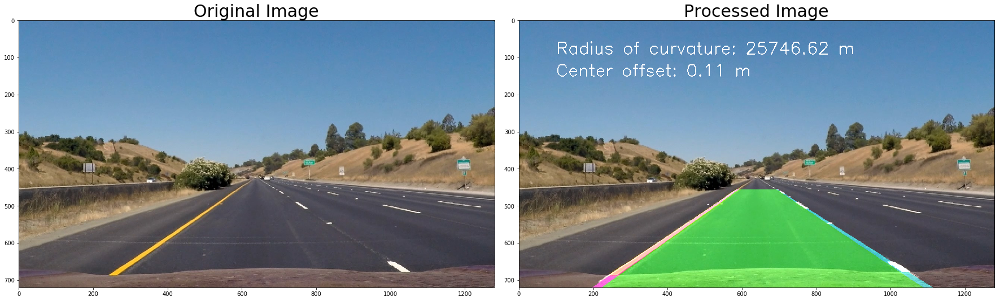

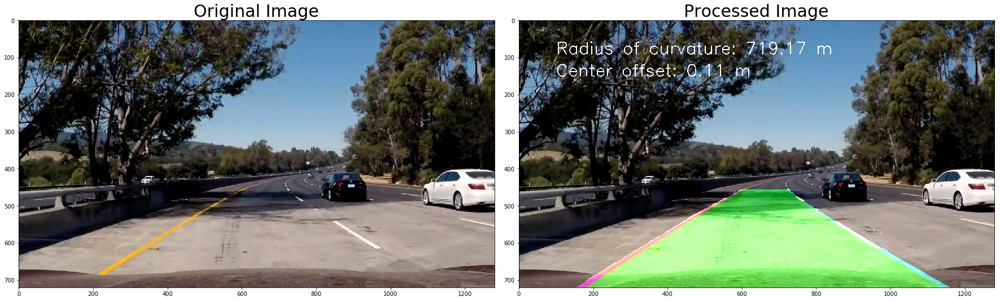

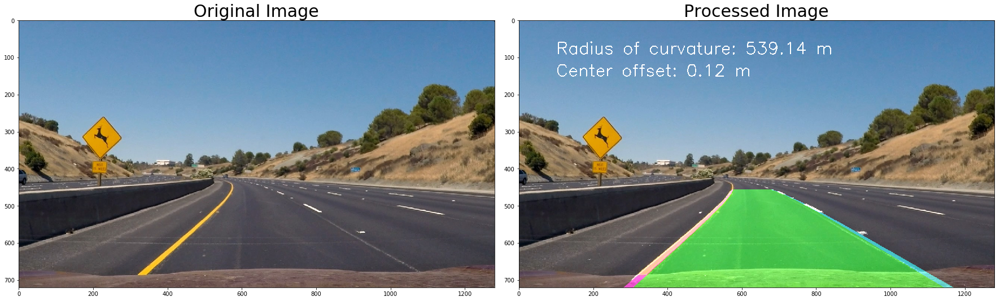

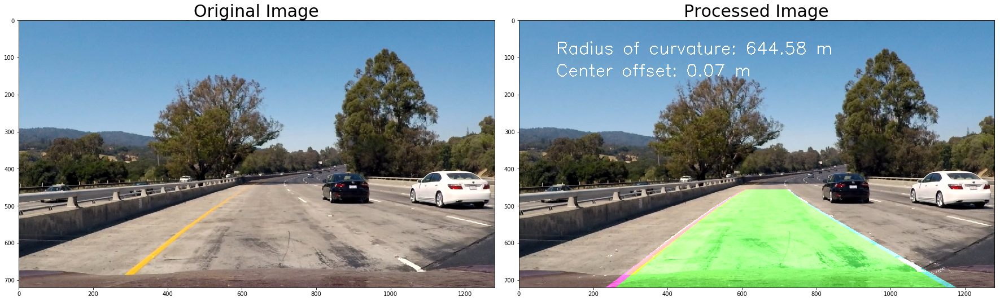

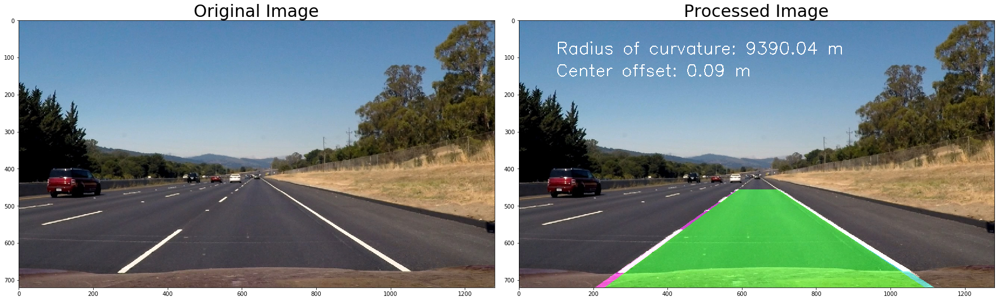

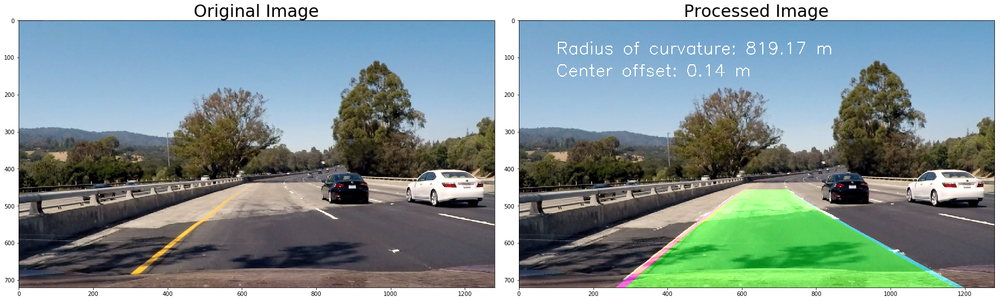

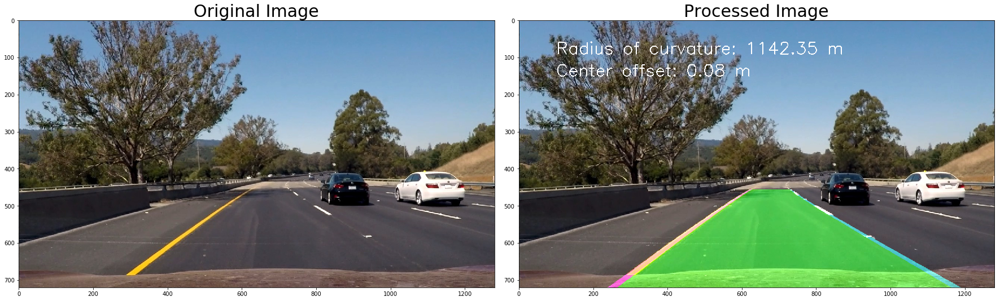

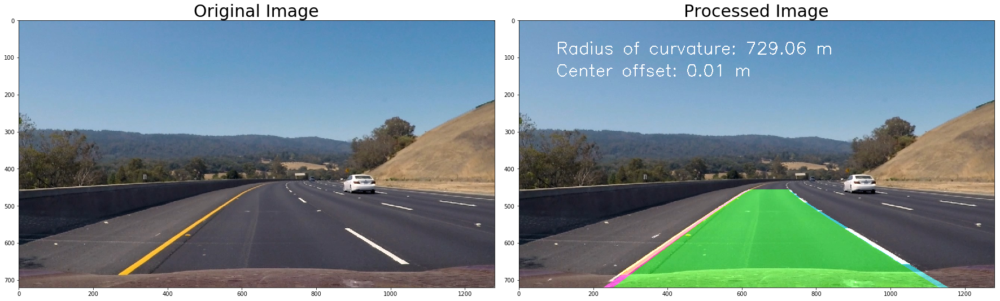

In [203]:
# Reset global variables
reset_prev()

# Calibrating camera
calibrating_dir = "camera_cal/"
calibrating_camera(show=False, directory=calibrating_dir)    

# Read from disk and find the lines
test_img_dir = "test_images/"

for img_name in os.listdir(test_img_dir):
    if img_name[0:7] != "result_":
        
        print  ("Processing image: " + img_name)
        
        #reading in an image
        img_input = mpimg.imread(test_img_dir + img_name)
        
        # Apply pipeline
        img_out = processing_pipeline_image(img_input)

        # Convert image
        img_out_rgb = cv2.cvtColor(img_out, cv2.COLOR_BGR2RGB)
        cv2.imwrite('output_images/result_' + img_name ,img_out_rgb)

        # Display the images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img_input)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(cv2.cvtColor(img_out_rgb, cv2.COLOR_BGR2RGB))
        ax2.set_title('Processed Image', fontsize=30)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# 9.3 Processing Video

In [181]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### 9.3.1 Pipeline: Project Video

In [182]:
def process_image(image):

    return processing_pipeline_image(image)

In [187]:
# Reinitialize some global variables.
reset_prev()

# Calibrating camera
calibrating_dir = "camera_cal/"
calibrating_camera(show=False, directory=calibrating_dir) 

# Output video
project_output = 'output_videos/result_project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(process_image)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video output_videos/result_project_video.mp4
[MoviePy] Writing video output_videos/result_project_video.mp4


100%|█████████▉| 1260/1261 [06:56<00:00,  3.12it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/result_project_video.mp4 

CPU times: user 4min 18s, sys: 23.3 s, total: 4min 41s
Wall time: 6min 59s


In [188]:
from IPython.display import HTML
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(project_output))

### 9.3.2 Pipeline: Challenge Video

In [81]:
# Reinitialize some global variables.
reset_prev()

# Calibrating camera
calibrating_dir = "camera_cal/"
calibrating_camera(show=False, directory=calibrating_dir) 

# Output video
challenge_output = 'output_videos/result_challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip2 = VideoFileClip("challenge_video.mp4").subclip(0,5)
clip2 = VideoFileClip("challenge_video.mp4")
challenge_clip = clip2.fl_image(processing_pipeline_image)
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video output_videos/result_challenge_video.mp4
[MoviePy] Writing video output_videos/result_challenge_video.mp4


100%|██████████| 485/485 [02:24<00:00,  3.20it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/result_challenge_video.mp4 

CPU times: user 1min 34s, sys: 1.1 s, total: 1min 35s
Wall time: 2min 27s


In [82]:
from IPython.display import HTML
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(challenge_output))

### 9.3.3 Pipeline: Harder Challenge Video

In [125]:
# Reinitialize some global variables.
reset_prev()

# Calibrating camera
calibrating_dir = "camera_cal/"
calibrating_camera(show=False, directory=calibrating_dir) 

# Output video
harder_challenge_output = 'output_videos/result_harder_challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip3 = VideoFileClip("harder_challenge_video.mp4").subclip(0,5)
clip3 = VideoFileClip("harder_challenge_video.mp4")
harder_challenge_clip = clip3.fl_image(processing_pipeline_image)
%time harder_challenge_clip.write_videofile(harder_challenge_output, audio=False)

[MoviePy] >>>> Building video output_videos/result_harder_challenge_video.mp4
[MoviePy] Writing video output_videos/result_harder_challenge_video.mp4


100%|█████████▉| 1199/1200 [07:15<00:00,  2.86it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/result_harder_challenge_video.mp4 

CPU times: user 4min 26s, sys: 3.98 s, total: 4min 30s
Wall time: 7min 19s


In [127]:
from IPython.display import HTML
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_output))